## Mitigating salary bias due to gender using Automl fairness

### Table of Content

- [Introduction](#Introduction)
- [Necessary Imports](#necessary-imports)
- [Accessing the dataset](#accessing-dataset)
- [Model Building using AutoML](#Model-building)
- [Check fairness of unmitigated model](#fairness-score)
    - [Analyse model fairness](#fairness-score1)
    - [Choosing a Metric](#choosing-metric)
- [Check fairness score of trained model](#fairness-score1)
- [Mitigation using demographic parity ratio](#mitigation-dpr)
- [DPR mitigation Analysis](#analysis-dpr)
- [Mitigation using Equalized Odds Ratio](#conclusion)
- [Reducing the threshold for a successful mitigation](#conclusion)
- [Conclusion](#conclusion)
- [Data resources](#resources)

### Introduction <a id='Introduction'></a>

Bias is prevalent in most datasets, often introduced during data collection and due to other factors. While preprocessing typically addresses problems such as missing data, corrupted records, outliers, featue engineering, etc., bias in datasets is frequently overlooked. Consequently, models trained on biased data can produce biased predictions. To address this, we present an elaborate methodology demonstrating detection and mitigation of gender bias in predicting salaries as a specific case study. Removing bias is a complex process, and we leverage the capabilities of AutoML to both remove bias and identify optimal unbiased models.

### Necessary Imports <a id="necessary-imports"></a>

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt

import pandas as pd

import arcgis
from arcgis.gis import GIS


from arcgis.learn import prepare_tabulardata, AutoML
from sklearn.model_selection import train_test_split

from arcgis.learn import prepare_tabulardata, AutoML
from sklearn.metrics import accuracy_score

## Connecting to ArcGIS 

In [2]:
gis = GIS("home")

### Accessing the dataset <a id='accessing-dataset'></a>

The dataset comprises demographic and employment information for a diverse group of individuals in the United States, featuring variables such as age, education level, occupation, marital status, salary, and more. Our goal is to train a model that predicts whether an individual's salary is above or below 50k.

<Item title:"salary" type:CSV owner:api_data_owner>
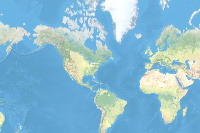

In [3]:
data_table = gis.content.get("9f56292f1bec417da75d577bbd131889")
data_table

In [4]:
# Download the csv and saving it in local folder
data_path = data_table.get_data()

In [5]:
adult_income = pd.read_csv(data_path).drop(["Unnamed: 0"], axis=1)
adult_income.head()

,Age,Workclass,Fnlwgt,Education,Education-num,Marital-status,Occupation,Relationship,Race,Gender,Capital-gain,Capital-loss,Hours-per-week,Native-country,Salary,annual_salary_$
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K,64375
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K,19304
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K,55493
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K,78591
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K,55388



The dataset consists of 32,561 records, with 21,790 males and 10,771 females, suggesting a bias favoring males. The age range is from 18 to 59 years old. The majority of the individuals are from the United States (93%), with a few from Puerto Rico, Jamaica, and Cuba. The most common education level is HS-grad (34%), followed by Some-college (20%), and Bachelors (15%). The majority of the individuals are married (63%), with a significant number being divorced (15%) or never-married (12%).


In [6]:
adult_income.columns

Index(['Age', 'Workclass', 'Fnlwgt', 'Education', 'Education-num',
       'Marital-status', 'Occupation', 'Relationship', 'Race', 'Gender',
       'Capital-gain', 'Capital-loss', 'Hours-per-week', 'Native-country',
       'Salary', 'annual_salary_$'],
      dtype='object')

# Data processing

Data processing consists of first splitting the dataset into a training dataset and a testing dataset as follows:

In [7]:
test_size = 0.20
train, test = train_test_split(adult_income, test_size = test_size, random_state=32, shuffle=True)

### Model Building using AutoML <a id='Model-building'></a>

First a baseline model will be trained using automl followed by diagnosing its fairness score. This will be a classification model trained using relevant demographic explanatory features from the dataset for predicting and classifying the salary of employees. Here Education-num, Capital-gain, Capital-loss and Hours-per-week are considered as continuous variable, and the rest are categorical. The target variable `Salary` has two classes, and is sutiable for the current automl implementation for fairness mitigation, which can handle only binary classification.  

### Data Preparation <a id='prepare_tabulardata'></a>

The preparation of the data is carried out by the prepare_tabulardata method from the arcgis.learn module in the ArcGIS API for Python. This function will take either a non spatial dataframe, a feature layer or a spatial dataframe containing the dataset as input and will return a TabularDataObject that can be fed into the model. Here we are using a non spatial dataframe.

The primary input parameters required for the tool are:

    input_features : non spatial dataframe containing the  primary dataset
    variable_predict : field name `Salary` as the y-variable to be predicted from the input dataframe
    explanatory_variables : The selected list of explanatory variables. 

In [8]:
explanatory_variables = [
    ('Age', True), ('Workclass', True), ('Education', True), 'Education-num',
    ('Marital-status', True), ('Occupation', True), ('Relationship', True),
    ('Race', True), ('Gender', True), 'Capital-gain', 'Capital-loss',
    'Hours-per-week', ('Native-country', True)
]

In [9]:
data = prepare_tabulardata(train, 'Salary', explanatory_variables=explanatory_variables)

Dataframe is not spatial, Rasters and distance layers will not work


In [10]:
data.show_batch() 

,Age,Capital-gain,Capital-loss,Education,Education-num,Gender,Hours-per-week,Marital-status,Native-country,Occupation,Race,Relationship,Salary,Workclass
1174,47,0,0,HS-grad,9,Male,40,Married-civ-spouse,United-States,Other-service,White,Husband,<=50K,Private
5093,34,0,0,HS-grad,9,Male,40,Married-civ-spouse,United-States,Machine-op-inspct,White,Husband,<=50K,Private
11204,46,0,1977,Masters,14,Male,40,Married-civ-spouse,United-States,Tech-support,White,Husband,>50K,Private
12586,30,0,0,Some-college,10,Female,40,Divorced,United-States,Adm-clerical,White,Not-in-family,<=50K,Local-gov
29133,30,0,0,11th,7,Male,40,Married-spouse-absent,Mexico,Handlers-cleaners,Amer-Indian-Eskimo,Not-in-family,<=50K,Private


### Model initialization 

Here we will initialize the AutoML model, by pasing the preprared tabular data from the above. Here we can also pass the mode of the model as Basic, Intermediate or Advanced. The default is Basic.

In [11]:
automl_classifier_plain = AutoML(data=data)

### Model training

Finally, the model is now ready for training. To train the model, the model.fit() function is called. Based on the mode of the model it will start traning, and train for relevant epochs untill it finds the best model. Time taken will be less for the basic mode, and higher for the Intermediate mode and maxium for the advanced mode.

In terms of backbones, the model will use various available set of algortihms like Decision Tree, Random Trees, Extra Trees, LightGBM, Xgboost specialized for tabular data, includng model ensembling to find the best model.

In [12]:
automl_classifier_plain.fit()

Neural Network algorithm was disabled because it doesn't support n_jobs parameter.
Linear algorithm was disabled.
AutoML directory: C:\Users\sup10432\AppData\Local\Temp\scratch\tmpfvj5jmu4
The task is binary_classification with evaluation metric logloss
AutoML will use algorithms: ['Decision Tree', 'Random Trees', 'Extra Trees', 'LightGBM', 'Xgboost']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 1 model
DecisionTreeAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
y_true takes value in {' <=50K', ' >50K'} and pos_label is not specified: either make y_true take value in {0, 1} or {-1, 1} or pass pos_label explicitly.
1_DecisionTree logloss 0.361375 trained in 6.29 seconds
* Step

Once trained the model score is checked to understand the performance of the trained model. 

In [13]:
automl_classifier_plain.score()

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


0.7439539347408829

Additional insights into model performance can be observed from the model report, which includes the AutoML leaderboard, performance metrics for each algorithm attempted, a boxplot depicting model performance, and Spearman correlation analysis.

In [14]:
automl_classifier_plain.report()

In case the report html is not rendered appropriately in the notebook, the same can be found in the path C:\Users\sup10432\AppData\Local\Temp\scratch\tmpfvj5jmu4\README.html


### Check fairness of unmitigated model for gender<a id='fairness-score'></a>

Now, before proceeding, we need to verify if the baseline model exhibits bias and determine if mitigation is necessary. Initially, the fairness score of the baseline AutoML model is assessed to identify any gender-related bias, its type, and magnitude.

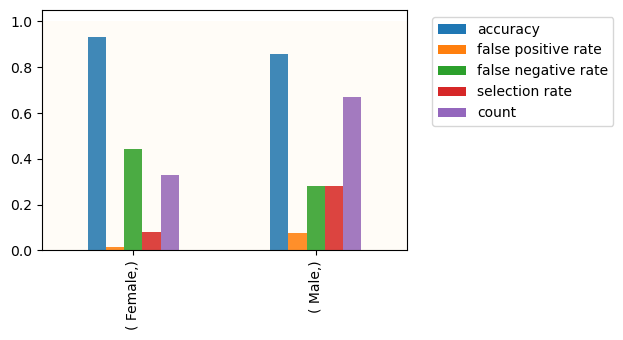

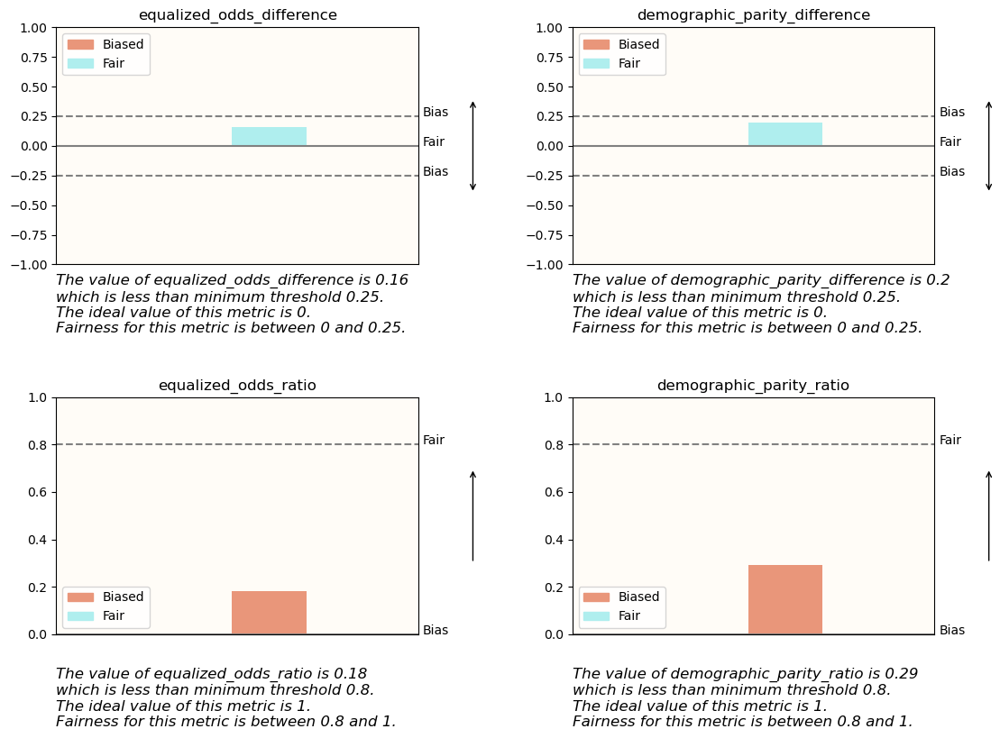

In [15]:
%matplotlib inline
fairness_df = automl_classifier_plain.fairness_score(sensitive_feature ='Gender', visualize=True)

In the above it shows output of four metrics measuring fairness for the classification problems. Equalized odds difference(EOD), Demographic parity difference(DPR), Equalized odds ratio(EOR), Demographic parity ratio(DPR). The ranges of these metrics can be interpreted as explained below. To know more detail about the metrics you can check the [how fairness works](https://pro.arcgis.com/en/pro-app/latest/tool-reference/geoai/how-fairness-works.htm) documentation page. 

In [16]:
fairness_df[1]

{'equalized_odds_difference': (0.16,
  'The value of equalized_odds_difference is 0.16 which is less than minimum threshold 0.25. The ideal value of this metric is 0. Fairness for this metric is between 0 and 0.25.'),
 'demographic_parity_difference': (0.2,
  'The value of demographic_parity_difference is 0.2 which is less than minimum threshold 0.25. The ideal value of this metric is 0. Fairness for this metric is between 0 and 0.25.'),
 'equalized_odds_ratio': (0.18,
  'The value of equalized_odds_ratio is 0.18 which is less than minimum threshold 0.8. The ideal value of this metric is 1. Fairness for this metric is between 0.8 and 1.'),
 'demographic_parity_ratio': (0.29,
  'The value of demographic_parity_ratio is 0.29 which is less than minimum threshold 0.8. The ideal value of this metric is 1. Fairness for this metric is between 0.8 and 1.')}

Here the fairness score reveals that the prediciton is biased as reflected by the equalized odds ratio and the demographic parity ratio both of which are less than the minimum value of 0.8 and the ideal value of 1.

In [17]:
fairness_df[0]

,accuracy,false positive rate,false negative rate,selection rate,count
"( Female,)",0.933798,0.013245,0.443396,0.080139,0.330518
"( Male,)",0.858372,0.074387,0.283422,0.280963,0.669482


#### Analyse model fairness  <a id='fairness-score1'></a>

In the above fairness report the Equalized Odds Ratio (EOR) and Demographic Parity Ratio (DPR) are the two critical metrics that reveal significant unfairness in the prediction outcomes between different genders. These metrics should be the primary focus for mitigation efforts. Strategies such as algorithmic adjustments, feature selection, or targeted interventions may be needed to address the observed biases and improve fairness in salary predictions.

#### Choosing a Metric<a id='choosing-metric'></a>     

If the primary concern is to ensure fairness in both false positives and false negatives, then Equalized Odds Ratio (EOR) would be the preferred metric for bias mitigation. Addressing disparities in both types of errors can lead to a more balanced and equitable outcome.

However, if the focus is solely on ensuring an equal distribution of positive outcomes between genders, then Demographic Parity Ratio (DPR) might be sufficient for mitigation efforts.

In the context of this example:

Equalized Odds Ratio (EOR):

EOR focuses on ensuring fairness in both false positives and false negatives between different males and females genders. Specifically, EOR (0.18) indicates that the odds of a true positive prediction for the protected group (e.g., females) are 18% of those for the unprotected group (e.g., males).Mitigating bias using EOR means adjusting the model to achieve more balanced error rates across genders, thereby reducing disparities in both types of prediction errors (false positives and false negatives).

Demographic Parity Ratio (DPR):

DPR primarily aims to ensure an equal distribution of positive outcomes (e.g., salary above 50k) between different the genders, regardless of predictive errors. In this example, DPR (0.29) indicates that the ratio of positive outcomes for the  females is 29% of that for males. Mitigating bias using DPR involves adjusting the model to achieve parity in positive outcome rates across genders, without necessarily addressing disparities in prediction errors.

Following this diagnosis, we will now attempt to mitigate the demographic parity ratio bias caused by gender. First we will initialize the automl model with the fairness metric for bias mitigation. 

### Mitigation using demographic parity ratio<a id='mitigation-dpr'></a> 

The first step for mitigation is to identify a sensitive feature in the data that is introducing the bias and specify an appropriate fairness metric based on clasification or regresssion problem. Thus we initiate the model using the sensitive variable as Gender and the metric as DPR. DPR defines the fairness metric to be optimize during model training and adjusted to achieve demographic parity in positive outcomes (salary) between different gender groups. Other paramters that can be used are fairness_threshold, and underprivileged_groups, but the defaults values are used here. Refer the earlier link for more detail.

In [18]:
automl_mitigation_dpr_obj = AutoML(data,sensitive_variables= ['Gender'], fairness_metric = 'demographic_parity_ratio')

After creating the AutoML object by passing the data obtained from prepare_tabulardata and using mitigation values for other parameters, now we proceed to train the model using AutoML. This is done by calling the fit method as shown below. After training all the models and their variants are saved in a new folder.

In [19]:
automl_mitigation_dpr_obj.fit()

Neural Network algorithm was disabled because it doesn't support n_jobs parameter.
Linear algorithm was disabled.
AutoML directory: C:\Users\sup10432\AppData\Local\Temp\scratch\tmp__c4b209
The task is binary_classification with evaluation metric logloss
AutoML will use algorithms: ['Decision Tree', 'Random Trees', 'Extra Trees', 'LightGBM', 'Xgboost']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'unfairness_mitigation', 'ensemble']
* Step simple_algorithms will try to check up to 1 model
DecisionTreeAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
y_true takes value in {' <=50K', ' >50K'} and pos_label is not specified: either make y_true take value in {0, 1} or {-1, 1} or pass pos_label explicitly.
1_DecisionTree logloss 0.361375 train

Once the model is trained, it will have mitigated the bias. This can be verified by reviewing the model report and examining the demographic parity ratio metric of the best-trained model.  

In [20]:
automl_mitigation_dpr_obj.report()

In case the report html is not rendered appropriately in the notebook, the same can be found in the path C:\Users\sup10432\AppData\Local\Temp\scratch\tmp__c4b209\README.html


Best model,name,model_type,metric_type,metric_value,train_time,fairness_metric,fairness_Gender,is_fair
,1_DecisionTree,Decision Tree,logloss,0.361375,7.75,demographic_parity_ratio,0.1344,False
,2_Default_LightGBM,LightGBM,logloss,0.27688,6.52,demographic_parity_ratio,0.3252,False
,4_Default_RandomTrees,Random Trees,logloss,0.338299,10.23,demographic_parity_ratio,0.332,False
,5_Default_ExtraTrees,Extra Trees,logloss,0.368012,9.44,demographic_parity_ratio,0.2844,False
,4_Default_RandomTrees_SampleWeigthing,Random Trees,logloss,0.35729,10.06,demographic_parity_ratio,0.3612,False
,2_Default_LightGBM_SampleWeigthing,LightGBM,logloss,0.285305,6.22,demographic_parity_ratio,0.5264,False
,5_Default_ExtraTrees_SampleWeigthing,Extra Trees,logloss,0.384304,9.67,demographic_parity_ratio,0.7682,False
,1_DecisionTree_SampleWeigthing,Decision Tree,logloss,0.423913,7.76,demographic_parity_ratio,0.4991,False
,5_Default_ExtraTrees_SampleWeigthing_Update_1,Extra Trees,logloss,0.412036,14.89,demographic_parity_ratio,0.9246,True
,2_Default_LightGBM_SampleWeigthing_Update_1,LightGBM,logloss,0.295114,6.28,demographic_parity_ratio,0.6955,False


The model report shows that `2_Default_LightGBM_SampleWeigthing_Update_2` is the best trained model and the respective    demograpihc_parity_ratio is now 0.84 which is up from 0.29, which is also higher than the minimum threshold of 0.80. Hence we can consider the model is now mitigated. The model score is checked to see if the model performance is retained, which is same as before.

### DPR mitigation Analysis <a id='analysis-dpr'></a>

###### <center>Model Performance Metrics Before and After Mitigation for female:</center>
| | Accuracy (Female) | False Positive Rate (Female) | False Negative Rate (Female) | Selection Rate (Female) | Count (Female) |
|- |- |- |- |- |- |
|Before Mitigation|0.933798|0.013245|0.443396|0.080139|0.330518|
|After Mitigation|0.8949|0.0979|0.1645|0.1782|0.2121|

###### <center>Model Performance Metrics Before and After Mitigation for male:</center>
| | Accuracy (Male) | False Positive Rate (Male) | False Negative Rate (Male) | Selection Rate (Male) | Count (Male) |
|- |- |- |- |- |- |
|Before Mitigation|0.858372|0.074387|0.283422|0.280963|0.669482|
|After Mitigation|0.8394|0.0473|0.4162|0.212|0.4391|

#### Selection Rate:

Selection Rate can be defined as the proportion of samples from a specific sensitive group that were selected or predicted as positive by the model. For example, for the male group, a selection rate value of 0.2809 indicates that approximately 28.09 percent of male samples were predicted as positive outcomes by the model.

Before mitigation, the selection rate for females (0.0801) was significantly lower than for males (0.2809).

After mitigation, the selection rates have become more balanced, with males at 0.2120 and females at 0.1782. This indicates an improvement in demographic parity, ensuring more equitable selection between genders.

#### False Negative Rate:

Before mitigation, females had a much higher rate of being incorrectly classified as earning less than 50k (false negatives) at 0.4433, compared to males at 0.2834.

After mitigation, the rate of females being incorrectly classified as earning less than 50k (false negatives) significantly decreased to 0.1645, indicating an improvement in correctly identifying females earning above 50k.

However, the rate of males being incorrectly classified as earning less than 50k (false negatives) increased from 0.2834 to 0.4162. This indicates that while the mitigation process improved the false negative rate for females, it had an adverse effect on the false negative rate for males.

#### Overall Accuracy:

The overall accuracy decreased slightly from the pre-mitigation accuracy levels (males: 0.858372, females: 0.933798) to 0.8575 after mitigation. This is a minor change and indicates that overall predictive performance was maintained.


The mitigation strategy improved demographic parity by balancing the selection rates between males and females, but this came at the cost of increasing the false negative rate for males. This trade-off suggests that while aiming for fairness in selection rates, other metrics such as the false negative rate can be adversely affected.

The mitigation achieved in selection rate shows progress towards demographic parity, ensuring a fairer selection process between genders. However, the increase in the false negative rate for males is a concern, as it indicates more males are being incorrectly classified as negative cases after mitigation. Balancing fairness and performance metrics like false negative rate is crucial, and further adjustments or different mitigation techniques may be necessary to achieve a more equitable outcome without compromising accuracy.

In [23]:
automl_mitigation_dpr_obj.score()

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


0.7439539347408829

Finally the mitigated model is used for final prediction on an unseen data:

In [24]:
result_df = automl_mitigation_dpr_obj.predict(test,prediction_type="dataframe")
result_df.head(5)

,Age,Workclass,Fnlwgt,Education,Education-num,Marital-status,Occupation,Relationship,Race,Gender,Capital-gain,Capital-loss,Hours-per-week,Native-country,Salary,annual_salary_$,prediction_results,prediction_confidence
24507,57,Private,89182,HS-grad,9,Widowed,Adm-clerical,Not-in-family,White,Female,0,0,40,United-States,<=50K,90732,<=50K,0.834847
28351,33,Private,159548,Some-college,10,Divorced,Adm-clerical,Unmarried,Black,Female,0,0,38,United-States,<=50K,87710,<=50K,0.974263
717,19,State-gov,378418,HS-grad,9,Never-married,Tech-support,Own-child,White,Female,0,0,40,United-States,<=50K,64787,<=50K,0.998881
19417,44,Private,151985,Masters,14,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,24,United-States,>50K,83582,>50K,0.939446
16746,23,Private,406641,Some-college,10,Never-married,Handlers-cleaners,Other-relative,White,Female,0,0,18,United-States,<=50K,86347,<=50K,0.998467


In the predicted dataframe, the `prediction_results` column contains the model's predictions. To validate these predictions, they are compared with the actual values. The accuracy, which is then calculated, shows a high value. Significantly this prediction can be now considered free of bias.

In [26]:
accuracy = accuracy_score(result_df["Salary"], result_df['prediction_results'])
print(accuracy)

0.8628896054045755


### Mitigation using Equalized Odds Ratio

To address some of the shortcomings of Demographic Parity Ratio (DPR), let's mitigate the model using Equalized Odds Ratio (EOR). EOR aims to balance fairness and performance metrics by considering both false positive and false negative outcomes. 

The aim of the Equalized Odds fairness metric is to guarantee that a machine learning model exhibits equal performance across different demographic groups. It imposes a stricter criterion than demographic parity by mandating that the model's predictions are not only independent of the feemale and male sensitive group membership but also that the false positive rates and true positive rates are equal across groups. This distinction holds significance because while a model may achieve demographic parity, meaning its predictions are independent of sensitive group membership, it could still produce a higher number of false positive predictions for one group compared to others. Equalized Odds mitigates this concern by ensuring fairness in both false positive and true positive rates across all groups. Unlike demographic parity, Equalized Odds does not introduce the selection issue discussed previously. For instance, in case of the present scenario where the objective is to predict salary from male and female gender  ensuring the model performs equally well in predictign appropriate salary from both groups.

In [27]:
automl_mitigation_eqr_obj = AutoML(data,sensitive_variables= ['Gender'], fairness_metric = 'equalized_odds_ratio')

In [28]:
automl_mitigation_eqr_obj.fit()

Neural Network algorithm was disabled because it doesn't support n_jobs parameter.
Linear algorithm was disabled.
AutoML directory: C:\Users\sup10432\AppData\Local\Temp\scratch\tmppbdan7vj
The task is binary_classification with evaluation metric logloss
AutoML will use algorithms: ['Decision Tree', 'Random Trees', 'Extra Trees', 'LightGBM', 'Xgboost']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'unfairness_mitigation', 'ensemble']
* Step simple_algorithms will try to check up to 1 model
DecisionTreeAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
y_true takes value in {' <=50K', ' >50K'} and pos_label is not specified: either make y_true take value in {0, 1} or {-1, 1} or pass pos_label explicitly.
1_DecisionTree logloss 0.361375 train

Once the model is trained, it will have mitigated the bias. This can be verified by reviewing the model report and examining the Equalized odds ratio metric of the best-trained model. 

In [29]:
automl_mitigation_eqr_obj.report()

In case the report html is not rendered appropriately in the notebook, the same can be found in the path C:\Users\sup10432\AppData\Local\Temp\scratch\tmppbdan7vj\README.html


Best model,name,model_type,metric_type,metric_value,train_time,fairness_metric,fairness_Gender,is_fair
,1_DecisionTree,Decision Tree,logloss,0.361375,10.13,equalized_odds_ratio,0.0153,False
,2_Default_LightGBM,LightGBM,logloss,0.27688,6.85,equalized_odds_ratio,0.2679,False
,4_Default_RandomTrees,Random Trees,logloss,0.338299,10.94,equalized_odds_ratio,0.2314,False
,5_Default_ExtraTrees,Extra Trees,logloss,0.368012,9.97,equalized_odds_ratio,0.1706,False
the best,2_Default_LightGBM_SampleWeigthing,LightGBM,logloss,0.285305,6.56,equalized_odds_ratio,0.7195,False
,4_Default_RandomTrees_SampleWeigthing,Random Trees,logloss,0.35729,10.76,equalized_odds_ratio,0.3123,False
,5_Default_ExtraTrees_SampleWeigthing,Extra Trees,logloss,0.384304,10.51,equalized_odds_ratio,0.6825,False
,1_DecisionTree_SampleWeigthing,Decision Tree,logloss,0.423913,7.89,equalized_odds_ratio,0.6193,False
,2_Default_LightGBM_SampleWeigthing_Update_1,LightGBM,logloss,0.295114,7.33,equalized_odds_ratio,0.6645,False
,5_Default_ExtraTrees_SampleWeigthing_Update_1,Extra Trees,logloss,0.412036,15.37,equalized_odds_ratio,0.5769,False


The model report shows that `2_Default_LightGBM_SampleWeigthing` is the best model. However the EOR metric shows that it was not able to construct a fair model, although there is significant improvement up from 0.18 to 0.71. This is close enough to the threshold of 0.8 to be considered a fair model. In fact the `fairness_threshold` parameter can be used to lower the EOR threshold to 0.71 for the model to be formally considered fair.

#### Reducing the threshold for a successful mitigation 

Thus acknowledging the fact that with EOR and threshold of 0.8 , the model was not able to find a fair model. But AuotoML was able to mitigate to an extent that EOR improved to 0.7 which is still a substantial improvement over 0.17.

Then we can formalize this by reducing the threshold to 0.7 in the API as well, and retrain the model.

In [30]:
automl_mitigation_eqr_obj = AutoML(data,sensitive_variables= ['Gender'], fairness_metric = 'equalized_odds_ratio', fairness_threshold=0.70)

In [31]:
automl_mitigation_eqr_obj.fit()

Neural Network algorithm was disabled because it doesn't support n_jobs parameter.
Linear algorithm was disabled.
AutoML directory: C:\Users\sup10432\AppData\Local\Temp\scratch\tmpejag8d56
The task is binary_classification with evaluation metric logloss
AutoML will use algorithms: ['Decision Tree', 'Random Trees', 'Extra Trees', 'LightGBM', 'Xgboost']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'unfairness_mitigation', 'ensemble']
* Step simple_algorithms will try to check up to 1 model
DecisionTreeAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
y_true takes value in {' <=50K', ' >50K'} and pos_label is not specified: either make y_true take value in {0, 1} or {-1, 1} or pass pos_label explicitly.
1_DecisionTree logloss 0.361375 train

In [32]:
automl_mitigation_eqr_obj.report()

In case the report html is not rendered appropriately in the notebook, the same can be found in the path C:\Users\sup10432\AppData\Local\Temp\scratch\tmpejag8d56\README.html


Best model,name,model_type,metric_type,metric_value,train_time,fairness_metric,fairness_Gender,is_fair
,1_DecisionTree,Decision Tree,logloss,0.361375,8.58,equalized_odds_ratio,0.0153,False
,2_Default_LightGBM,LightGBM,logloss,0.27688,7.21,equalized_odds_ratio,0.2679,False
,4_Default_RandomTrees,Random Trees,logloss,0.338299,11.17,equalized_odds_ratio,0.2314,False
,5_Default_ExtraTrees,Extra Trees,logloss,0.368012,9.95,equalized_odds_ratio,0.1706,False
the best,2_Default_LightGBM_SampleWeigthing,LightGBM,logloss,0.285305,6.76,equalized_odds_ratio,0.7195,True
,4_Default_RandomTrees_SampleWeigthing,Random Trees,logloss,0.35729,10.11,equalized_odds_ratio,0.3123,False
,5_Default_ExtraTrees_SampleWeigthing,Extra Trees,logloss,0.384304,10.02,equalized_odds_ratio,0.6825,False
,1_DecisionTree_SampleWeigthing,Decision Tree,logloss,0.423913,7.95,equalized_odds_ratio,0.6193,False
,5_Default_ExtraTrees_SampleWeigthing_Update_1,Extra Trees,logloss,0.412036,14.95,equalized_odds_ratio,0.5769,False
,1_DecisionTree_SampleWeigthing_Update_1,Decision Tree,logloss,0.462531,7.73,equalized_odds_ratio,0.0249,False


### EOR mitigation Analysis

###### <center>Model Performance Metrics Before and After Equalized Odds Ratio Mitigation for female:</center>
| | Accuracy  | False Positive Rate(FPR)  | False Negative Rate(FNR)  | Selection Rate  | 
|- |- |- |- |- |
|Before Mitigation|0.9337|0.0132|0.4433|0.0801| 
|After Mitigation|0.9312|0.0513|0.2121|0.1315|

###### <center>Model Performance Metrics Before and After Equalized Odds Ratio Mitigation for male:</center>
| | Accuracy  | False Positive Rate(FPR)  | False Negative Rate(FNR)  | Selection Rate  |
|- |- |- |- |- |
|Before Mitigation|0.8584|0.0744|0.2834|0.2810| 
|After Mitigation|0.8440|0.0713|0.3472|0.2498|

Now the model report shows the best model is fair. However from the comaprison table bove overall assessment shows that the mitigation strategy has led to mixed results:

Improvements:
Female FNR has significantly improved, reducing bias against females by lowering the rate of false negatives.
Female SR has increased, leading to a fairer representation of females in the positive selections. Male FPR has slightly decreased. 

Drawbacks:
The mitigation efforts have succeeded in balancing certain metrics across genders but have also introduced new biases, particularly in the false positive and false negative rates. Further fine-tuning of the mitigation technique might be necessary to achieve a more balanced and fair outcome across all metrics, including addition of more data.

### Conclusion <a id='conclusion'></a>

In this study, we explored the application of fairness metrics in machine learning, particularly focusing on the limitations and benefits of Demographic Parity Ratio (DPR) and Equalized Odds Ratio (EOR) for fairness assessment. 

First initial fairness assessment of the model was done predicting salary, utilizing demographic variable dataset using a vanilla automl workflow. The initial model showed discrepancies in fairness metrics, particularly with higher false positive rates for certain groups, revelaed by the Demographic Parity Ratio (DPR) and the Equalized Odds Ratio (EOR).

Subsequently fairness mitigation was done first with DPR and then with EOR. While DPR addressed some aspects of fairness, it fell short in balancing false positive and false negative rates across groups, leading to suboptimal performance in fairness. Then migating using the Equalized Odds Ratio metric provided a more comprehensive fairness assessment by ensuring equal false positive and true positive rates across all groups, thereby addressing the limitations observed with DPR.

Finally adjusting the threshold allowed automl to construct a fair model, which is useful for getting an Ensemble model. Otherwise if the model is not able to construct a fair model model ensemble is not created. 

Although there might be bias still present in the model, the mitigation workflow was able to reduce it significantly. Thus continuous evaluation and refinement of the fairness workflow would be crucial for achiving a more equitable machine learning models  and unbiased decision-making processes.    

### Data resources <a class="anchor" id="43"></a><a id='resources'></a>

| Dataset | Citation | Link |
| -| - |-|
|Census Income datset|Extraction was done by Barry Becker from the 1994 Census database|https://archive.ics.uci.edu/dataset/20/census+income|

                                                      ------End-----